# Advanced Lane Finding Project

The goals / steps of this project are the following:
* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

In [1]:
import glob
import cv2
import os
import numpy as np
import matplotlib.image as mpimg
import matplotlib.pyplot as plt

OUT = "output_images"
CACHE = "cache"
road_file = 'test_images/straight_lines1.jpg'
    
show = True
save = True



# Auxilery functions

In [2]:
def setup_figure(m_pics, w, h, n=10):
    return plt.subplots(1, m_pics, squeeze=True, sharex=True, sharey=True, figsize=(m_pics * n, h / w * n))        


def draw_lines(img, lines, color=[255, 0, 0], thickness=2, lanes_input=False):
    """
    NOTE: this is the function you might want to use as a starting point once you want to 
    average/extrapolate the line segments you detect to map out the full
    extent of the lane (going from the result shown in raw-lines-example.mp4
    to that shown in P1_example.mp4).  
    
    Think about things like separating line segments by their 
    slope ((y2-y1)/(x2-x1)) to decide which segments are part of the left
    line vs. the right line.  Then, you can average the position of each of 
    the lines and extrapolate to the top and bottom of the lane.
    
    This function draws `lines` with `color` and `thickness`.    
    Lines are drawn on the image inplace (mutates the image).
    If you want to make the lines semi-transparent, think about combining
    this function with the weighted_img() function below
    """
    
    if lanes_input:
        dynamic = False
        Y, X = img.shape[:2]
        lines_df = pd.DataFrame(np.squeeze(lines), columns=["x1", "y1", "x2", "y2"])
        lines_df["angle"] = lines_df.apply(lambda row: np.arctan2(row.y2 - row.y1, row.x2 - row.x1), axis="columns")

        lanes = {}
        for angle_sign in [-1,1]:
            filt = (np.sign(lines_df.angle) == angle_sign)

            x_ = lines_df[filt].x1.tolist() + lines_df[filt].x2.tolist()
            y_ = lines_df[filt].y1.tolist() + lines_df[filt].y2.tolist() 
            poly1d = np.polyfit(y_, x_, deg=1)
            width = 20
            if dynamic:
                # rotate to find width
                angle = lines_df.loc[filt, "angle"].mean()

                dx = lines_df.loc[filt, "x2"] - lines_df.loc[filt, "x1"]
                dy = lines_df.loc[filt, "y2"] - lines_df.loc[filt, "y1"]
                xr = dx * np.sin(angle) + dy * np.cos(angle) 
                yr = -dx * np.cos(angle) + dy * np.sin(angle) 

                if len(xr) == 1:
                    width = 20
                else:
                    width = min(int(np.std(xr)), 20)

            lanes[angle_sign] = {"poly": poly1d, "min": min(y_), "width": width}


        y_min = min(lanes[-1]["min"], lanes[1]["min"])
        for lane in lanes:
            p = lanes[lane]["poly"]
            pts = (np.polyval(p, Y), Y, np.polyval(p, y_min), y_min)
            cv2.line(img, (int(pts[0]), int(pts[1])), (int(pts[2]), int(pts[3])), color=[255, 0, 0], thickness=width)
                
    else:
        for line in lines:
            for x1,y1,x2,y2 in line:
                cv2.line(img, (x1, y1), (x2, y2), color, thickness)


# 1. Camera calibration


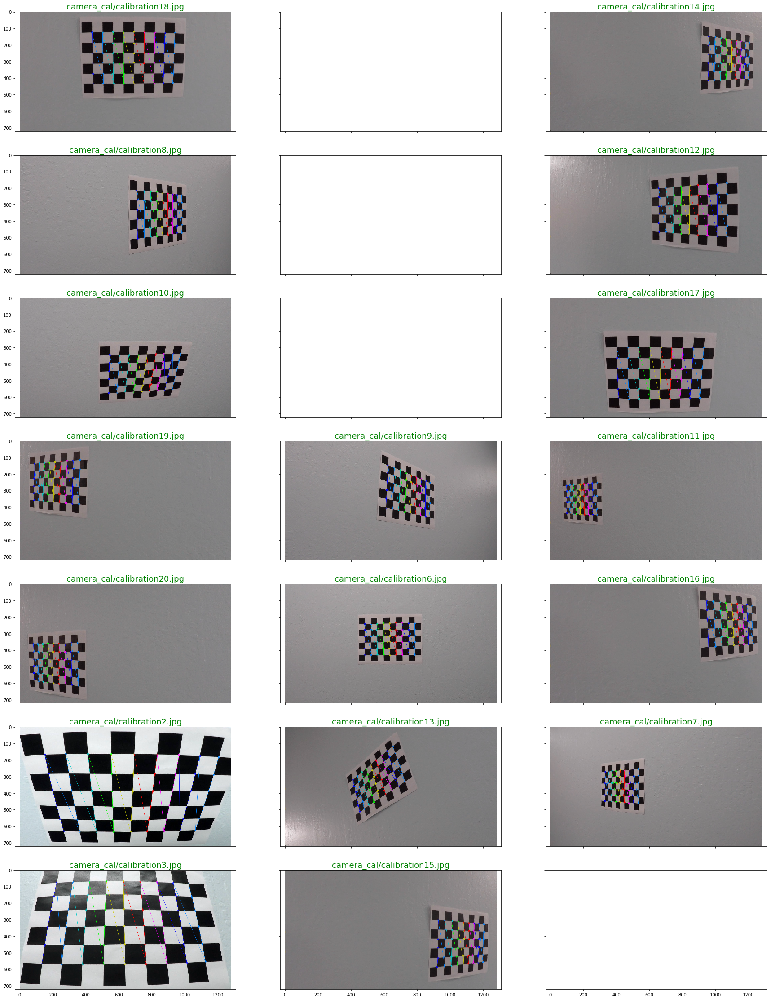

In [3]:
from pdb import set_trace as bp
class chessboard(object):
    
    def __init__(self, img_file, rows, cols, show=False, save=False, axes=None):
        self.img_file = img_file
        try:
            with open(self.img_file) as fd:
                self.img = cv2.imread(calib_file)
            self.gray = cv2.cvtColor(self.img, cv2.COLOR_BGR2GRAY)                
        except Excption as ex:
            print(ex)
            raise
        
        self.rows = rows
        self.cols = cols
        self.save = save
        self.show = show
        self.axes = axes

        
    @property
    def shape(self):
        return self.img.shape

    def findChessboardCorners(self):
        found, corners = cv2.findChessboardCorners(self.gray, (self.rows, self.cols), None)
        if not found:
            return None
            
            #raise Exception('{} not chessboard corners found'.format(self.img_file))
        
        criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)
        corners = cv2.cornerSubPix(image=self.gray, corners=corners, winSize=(7, 7), zeroZone=(-1, -1), criteria=criteria)
        
        if self.show or self.save:
            img = self.img.copy()
            cv2.drawChessboardCorners(img, (self.rows, self.cols), corners, found)
            
            if self.show:
                self.axes.imshow(img)
                self.axes.set_title(self.img_file, color='g', fontsize=18)

            if self.save:
                cv2.imwrite("{}/1_chessboard_{}".format(OUT, os.path.split(self.img_file)[-1]), img)
                
        return corners
    
always_show_chessboard = True
cols, rows = 9, 6
object_points = np.zeros((rows * cols, 3), np.float32)
object_points[:, :2] = np.mgrid[:rows, :cols].T.reshape(-1,2)


calibration_cache_file = '{}/calib.npz'.format(CACHE)

if not os.path.exists(calibration_cache_file) or always_show_chessboard:
    if show:
        f, axes = plt.subplots(7, 3, squeeze=True, sharex=True, sharey=True, figsize=(30, 40))
        axes = axes.flatten()

    image_corners, object_corners = [], []
    for i, calib_file in enumerate(glob.glob('camera_cal/*.jpg')):
        chessboard_i = chessboard(calib_file, rows, cols, show=show, save=save, axes=axes[i])
        corners = chessboard_i.findChessboardCorners()
        if corners is None:
            continue
        image_corners.append(corners)
        object_corners.append(object_points)
    else:
        # this should fit all versions of OpenCV
        try:
            ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(object_corners, image_corners, chessboard_i.shape[::-1], None, None)
        except:
            ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(object_corners, image_corners, chessboard_i.shape[::-1][1:3], None, None)
        np.savez(calibration_cache_file, mtx=mtx, dist=dist, rvecs=rvecs, tvecs=tvecs)

else:  # distortion parameters exist
    calib_params = np.load(calibration_cache_file)
    mtx = calib_params['mtx']
    dist = calib_params['dist']
    rvecs = calib_params['rvecs']
    tvecs = calib_params['tvecs']
    


# 2. Rectification - Undistort images

* define rectification class to handle parameters, action and save/show images

In [46]:
class Rectification(object):
    
    def __init__(self, distortion_file, save=False, show=False):
        self.distortion_file = distortion_file
        self.save = save
        self.show = show

        calib_params = np.load(self.distortion_file)
        self._mtx = calib_params['mtx']
        self._dist = calib_params['dist']
        self._rvecs = calib_params['rvecs']
        self._tvecs = calib_params['tvecs']
        

    def rectify(self, img, axes=None, filename=''):

        h, w = img.shape[:2]
        calibration_matrix, roi = cv2.getOptimalNewCameraMatrix(self._mtx, self._dist, (w, h), 1, (w, h))
        undistorted_img = cv2.undistort(img, mtx, dist, None, calibration_matrix)
        
        if self.show or self.save:
            stacked = np.concatenate((img, undistorted_img), axis=1)

        if self.show and not axes:
            plt.figure(figsize=(40, 10))
            plt.imshow(stacked)
        elif self.show:
            axes.imshow(stacked)
            axes.set_title(os.path.split(filename)[-1], color='g', fontsize=18)

        if self.save:
            if not filename:
                raise Exception("save image requires filename")
            

            cv2.imwrite('{}/{}'.format(OUT, filename), cv2.cvtColor(stacked, cv2.COLOR_BGR2RGB))
            
        return undistorted_img
        

* undistort chessboard images

rectify 2_undistorted_chessboard_calibration18.jpg
rectify 2_undistorted_chessboard_calibration5.jpg
rectify 2_undistorted_chessboard_calibration14.jpg
rectify 2_undistorted_chessboard_calibration8.jpg
rectify 2_undistorted_chessboard_calibration4.jpg
rectify 2_undistorted_chessboard_calibration12.jpg
rectify 2_undistorted_chessboard_calibration10.jpg
rectify 2_undistorted_chessboard_calibration1.jpg
rectify 2_undistorted_chessboard_calibration17.jpg
rectify 2_undistorted_chessboard_calibration19.jpg
rectify 2_undistorted_chessboard_calibration9.jpg
rectify 2_undistorted_chessboard_calibration11.jpg
rectify 2_undistorted_chessboard_calibration20.jpg
rectify 2_undistorted_chessboard_calibration6.jpg
rectify 2_undistorted_chessboard_calibration16.jpg
rectify 2_undistorted_chessboard_calibration2.jpg
rectify 2_undistorted_chessboard_calibration13.jpg
rectify 2_undistorted_chessboard_calibration7.jpg
rectify 2_undistorted_chessboard_calibration3.jpg
rectify 2_undistorted_chessboard_calibra

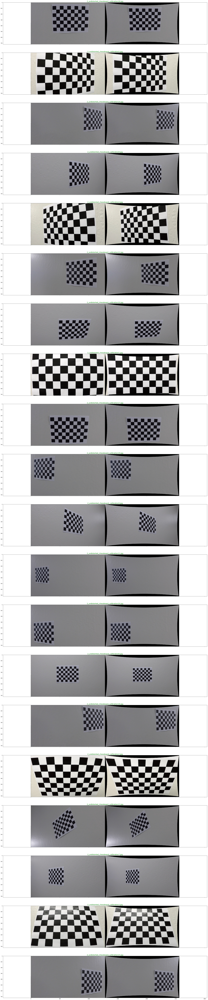

In [7]:
if show:
    N = len(os.listdir('camera_cal'))
    f, axes = plt.subplots(N, 1, squeeze=True, sharex=True, sharey=True, figsize=(40, 10 * N))

undistort = Rectification(distortion_file=calibration_cache_file, show=show, save=save)
for i, calib_file in enumerate(glob.glob('camera_cal/*.jpg')):
    img = mpimg.imread(calib_file)

    savename = '2_undistorted_chessboard_{}'.format(os.path.split(calib_file)[-1])
    undistorted = undistort.rectify(img, axes=axes[i], filename=savename)


- Provide an example of a distortion-corrected image.


rectify 2_straight_lines1.jpg


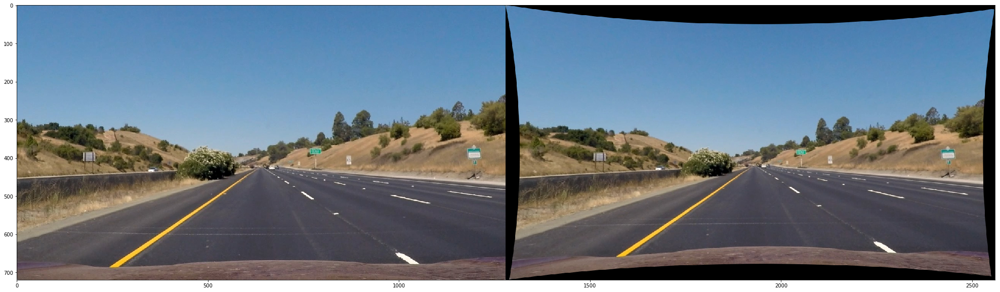

In [8]:
undistort = Rectification(distortion_file=calibration_cache_file, show=True, save=True)
# img = cv2.imread(road_file)
#img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)                
img = mpimg.imread(road_file)

undistorted = undistort.rectify(img, filename='2_{}'.format(os.path.split(road_file)[-1]))


# 3. Lane Masking


We will first implement this in the original frame


* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.


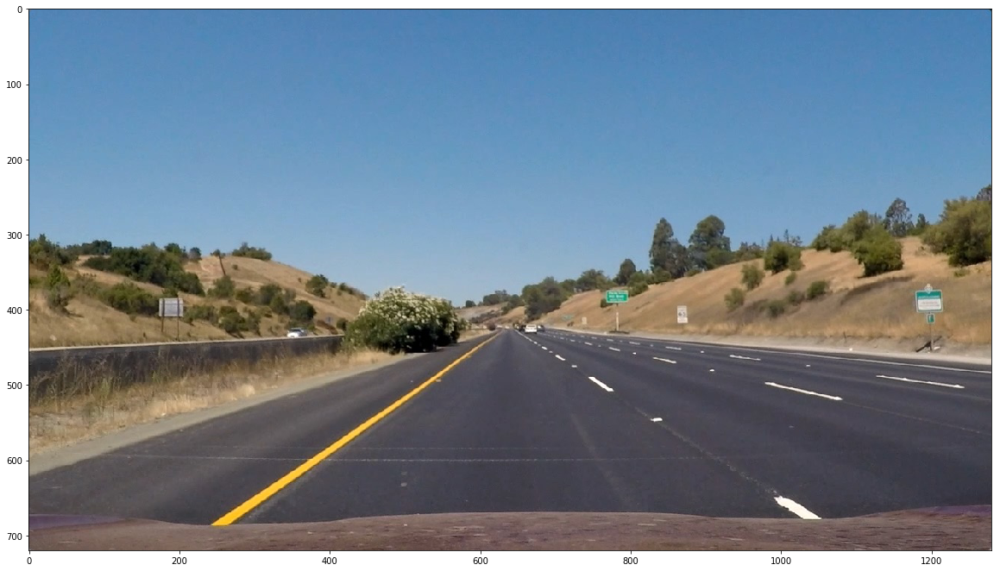

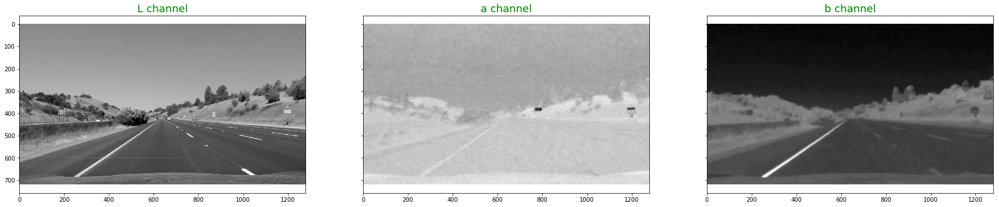

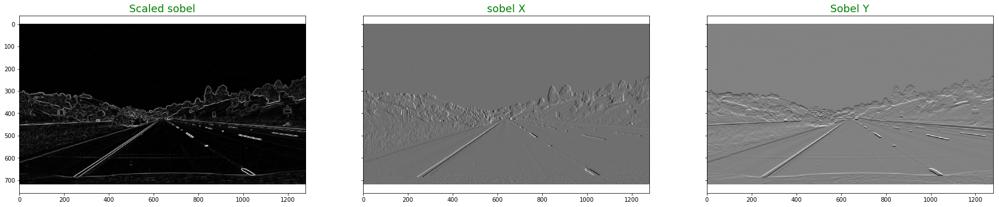

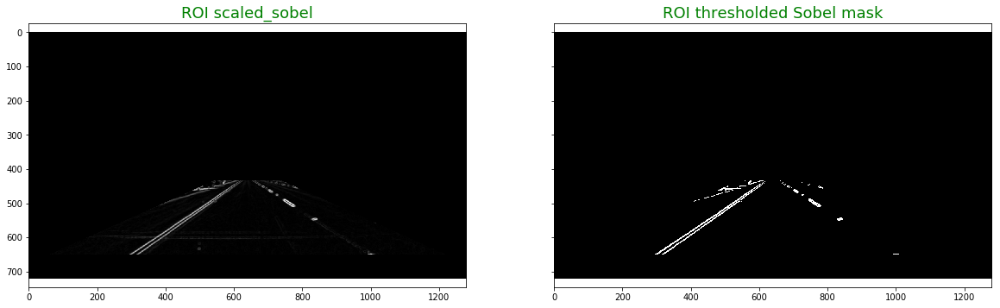

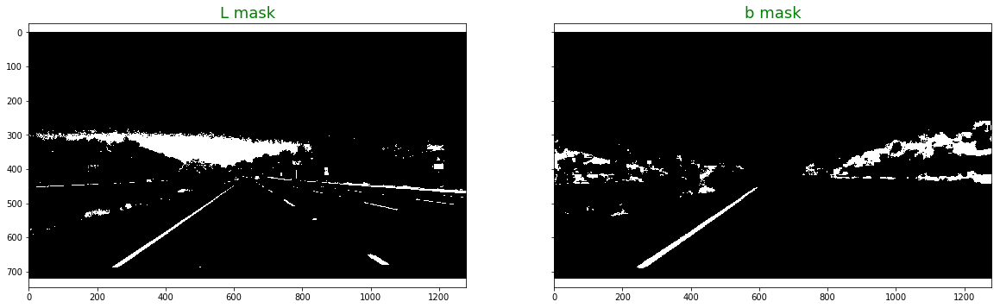

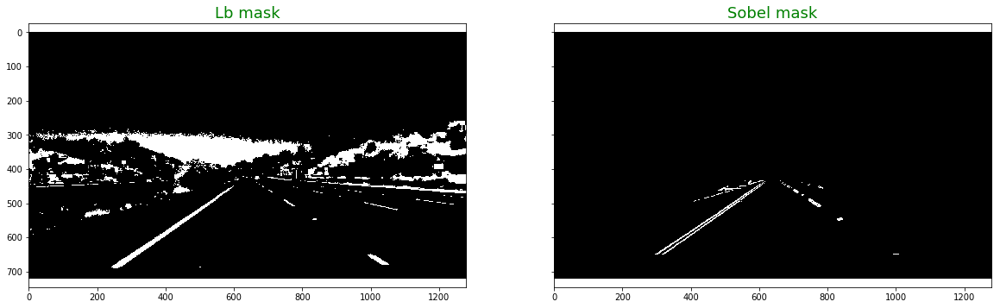

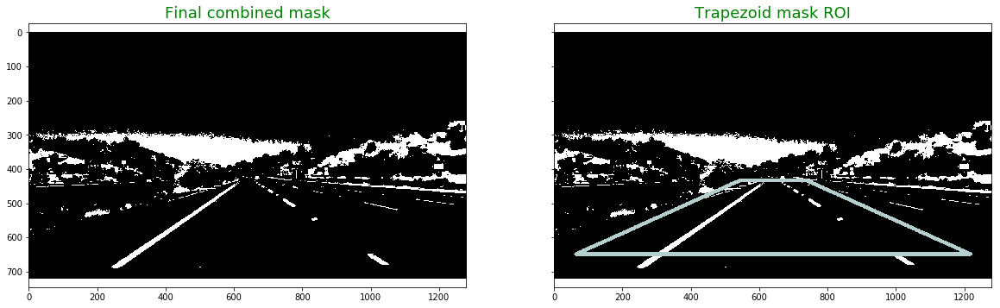

In [ ]:
# class Draw(object):
    
#             lines = [[bottom_left + bottom_right], [bottom_right + upper_right], [upper_right + upper_left], [upper_left + bottom_left]]
#             plt.figure(figsize = (10,10))
#             _tmp = Lc.copy()
#             draw_lines(_tmp, lines, color=[100, 0, 0], thickness=10)
    
class MaskPipeline(object):
    
    def __init__(self, trapzoid_params, save=False, show=False, nimage=-1):
        self.save = save
        self.show = show
        self.nimage = nimage
        self.trapzoid_params = trapzoid_params

    @staticmethod
    def _ROI(img, vertices):
        """
        Applies an image mask.

        Only keeps the region of the image defined by the polygon
        formed from `vertices`. The rest of the image is set to black.
        `vertices` should be a numpy array of integer points.
        """
        #defining a blank mask to start with
        mask = np.zeros_like(img)   

        #defining a 3 channel or 1 channel color to fill the mask with depending on the input image
        if len(img.shape) > 2:
            channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
            ignore_mask_color = (255,) * channel_count
        else:
            ignore_mask_color = 255

        #filling pixels inside the polygon defined by "vertices" with the fill color    
        cv2.fillPoly(mask, vertices, ignore_mask_color)

        #returning the image only where mask pixels are nonzero
        masked_image = cv2.bitwise_and(img, mask)
        return masked_image

    def trapezoid(self, img):
        Y, X = img.shape[:2]
        # calc ROI
        x_l = self.trapzoid_params["x_l"] #0.05 
        x_h = self.trapzoid_params["x_h"] #0.075
        y_h = self.trapzoid_params["y_h"] #0.9
        y_l = self.trapzoid_params["y_l"] #0.6
        bottom_left = [int(x_l * X), int(y_h * Y)]
        bottom_right = [int((1 - x_l) * X), int(y_h * Y)]
        upper_right = [int((0.5 + x_h) * X), int(y_l * Y)]
        upper_left = [int((0.5 - x_h) * X), int(y_l * Y)]
        return bottom_left, bottom_right, upper_right, upper_left    
    
    def region_of_interest(self, img):
        bottom_left, bottom_right, upper_right, upper_left = self.trapezoid(img)
        roi_lines = [np.array([bottom_left, bottom_right, upper_right, upper_left])]
        return self._ROI(img, roi_lines)
    
    def Sobel(self, L, sobel_kernel=5, percentile=99.5):
        h, w = img.shape[:2]
        
        L = cv2.GaussianBlur(L, (sobel_kernel, sobel_kernel), 0)
        
        sobel_x = cv2.Sobel(L, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
        sobel_y = cv2.Sobel(L, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
        sobel = np.sqrt(np.power(sobel_x, 2) + np.power(sobel_y, 2))

        scaled_sobel = np.uint8(255 * sobel / np.max(sobel))
        if self.show:
            n = 10
            m_pics = 3
#             f, axes = plt.subplots(1, m_pics, squeeze=True, sharex=True, sharey=True, figsize=(m_pics * n, h / w * n))
            fig, axes = setup_figure(m_pics, w, h)
                
            axes[0].imshow(scaled_sobel, cmap='gray')
            axes[0].set_title("Scaled sobel", color='g', fontsize=18)            
            axes[1].imshow(sobel_x, cmap='gray')
            axes[1].set_title("sobel X", color='g', fontsize=18)
            axes[2].imshow(sobel_y, cmap='gray')
            axes[2].set_title("Sobel Y", color='g', fontsize=18)
            
        scaled_sobel = self.region_of_interest(scaled_sobel)
        _, sobel_mask = cv2.threshold(scaled_sobel, np.percentile(scaled_sobel.flatten(), percentile), 255, cv2.THRESH_BINARY)
        if self.show:
            
            n = 10
            m_pics = 2
            #f, axes = plt.subplots(1, m_pics, squeeze=True, sharex=True, sharey=True, figsize=(m_pics * n, h / w * n))
            fig, axes = setup_figure(m_pics, w, h)
            
                
            axes[0].imshow(scaled_sobel, cmap='gray')
            axes[0].set_title("ROI scaled_sobel", color='g', fontsize=18)            
            axes[1].imshow(sobel_mask, cmap='gray')
            axes[1].set_title("ROI thresholded Sobel mask", color='g', fontsize=18)            

        return sobel_mask

    def intensity_mask(self, gray, percentile=95):
        _, mask = cv2.threshold(gray, np.percentile(gray.flatten(), percentile), 255, cv2.THRESH_BINARY)
        return mask

    def show_masks(self, h, w, l_mask, b_mask, Lb_mask, sobel_mask, combined_mask, roi_mask):

        if self.save:
            cv2.imwrite("{}/{}_Lb_mask_{}".format(OUT, self.nimage, os.path.split(img_file)[-1]), Lb_mask)
            cv2.imwrite("{}/{}_roi_sobel_mask_{}".format(OUT, self.nimage, os.path.split(img_file)[-1]), sobel_mask)
            cv2.imwrite("{}/{}_roi_combined_mask_{}".format(OUT, self.nimage, os.path.split(img_file)[-1]), roi_mask)

        if  self.show:

            fig, axes = setup_figure(2, w, h)
            axes[0].imshow(l_mask, cmap='gray')
            axes[0].set_title("L mask", color='g', fontsize=18)

            axes[1].imshow(b_mask, cmap='gray')
            axes[1].set_title("b mask", color='g', fontsize=18)

            fig, axes = setup_figure(2, w, h)

            axes[0].imshow(Lb_mask, cmap='gray')
            axes[0].set_title("Lb mask", color='g', fontsize=18)
            axes[1].imshow(sobel_mask, cmap='gray')
            axes[1].set_title("Sobel mask", color='g', fontsize=18)

            bottom_left, bottom_right, upper_right, upper_left = self.trapezoid(img)
            lines = [[bottom_left + bottom_right], [bottom_right + upper_right], \
                     [upper_right + upper_left], [upper_left + bottom_left]]

            _tmp = combined_mask.copy()
            draw_lines(_tmp, lines, color=[100, 0, 0], thickness=10)

            fig, axes = setup_figure(2, w, h)
            axes[0].imshow(combined_mask, cmap='gray')
            axes[0].set_title("Final combined mask", color='g', fontsize=18)

            axes[1].imshow(_tmp, cmap='bone')
            axes[1].set_title("Trapezoid mask ROI", color='g', fontsize=18)

            plt.figure(figsize=(20, 20))

            plt.imshow(roi_mask, cmap='gray')
            plt.title("Final ROI mask", color='g', fontsize=18)

    @staticmethod
    def skeletize(img):
        """ """
        size = np.size(img)
        skel = np.zeros(img.shape, np.uint8)
        element = cv2.getStructuringElement(cv2.MORPH_CROSS,(3,3))
        done = False

        while( not done):
            eroded = cv2.erode(img, element)
            temp = cv2.dilate(eroded, element)
            temp = cv2.subtract(img, temp)
            skel = cv2.bitwise_or(skel, temp)
            img = eroded.copy()

            zeros = size - cv2.countNonZero(img)
            if zeros==size:
                done = True

        # close little holes
        skel = cv2.morphologyEx(skel, cv2.MORPH_CLOSE, kernel=np.ones((5,5),np.uint8))
        return skel

    def process(self, img_file=None, img=None, sobel_kernel=7):

        if img is None:
            img = mpimg.imread(img_file)
        # perceptually uniform CIELab colorspace 
        h, w = img.shape[:2]
        if self.show:
            plt.figure(figsize=(20, 20))
            plt.imshow(img)
        
        lab_image = cv2.cvtColor(img, cv2.COLOR_RGB2LAB)
        channels_names = ("L channel", "a channel", "b channel")
        if self.show:
            fig, axes = setup_figure(3, w, h)
            for i in range(3):
                axes[i].imshow(lab_image[:,:,i], cmap='gray')
                axes[i].set_title(channels_names[i], color='g', fontsize=18)

        # like [::,i], but more elegant
        # l - lightness
        # a - greed/red
        # b - yellow/blue
        (l_channel, a_channel, b_channel) = cv2.split(lab_image)
        if self.save:
            stacked = np.concatenate((l_channel, a_channel, b_channel), axis=1)
            cv2.imwrite("{}/{}_LAB_{}".format(OUT, self.nimage, os.path.split(img_file)[-1]), stacked)

        sobel_mask = self.Sobel(l_channel)
        l_mask = self.intensity_mask(l_channel)
        b_mask = self.intensity_mask(b_channel)
        
        Lb_mask = cv2.bitwise_or(l_mask, b_mask)
        mask = cv2.bitwise_or(np.uint8(Lb_mask), np.uint8(sobel_mask))
        #combined_mask = np.unint8(cv2.addWeighted(Lb_mask, 0.7, sobel_mask, 0.3, 0))
        combined_mask = np.uint8((np.uint8(Lb_mask) + np.uint8(sobel_mask)) / 2)

        roi_mask = self.region_of_interest(combined_mask)
        #roi_mask = self.skeletize(roi_mask)
        roi_mask = cv2.erode(roi_mask, kernel=np.ones((7,7),np.uint8), iterations=1)
        roi_mask = cv2.morphologyEx(roi_mask, cv2.MORPH_CLOSE, kernel=np.ones((3,3),np.uint8))

        
        self.show_masks(h, w, l_mask, b_mask, Lb_mask, sobel_mask, combined_mask, roi_mask)
        

        return roi_mask

trapzoid_params = {"x_l": 0.05, "x_h": 0.075, "y_h":0.9, "y_l": 0.6}

binPipeline = MaskPipeline(show=show, save=save, trapzoid_params=trapzoid_params, nimage=3)

roi_mask = binPipeline.process(road_file)


# 4. Perspective transform

* Apply a perspective transform to rectify binary image ("birds-eye view").


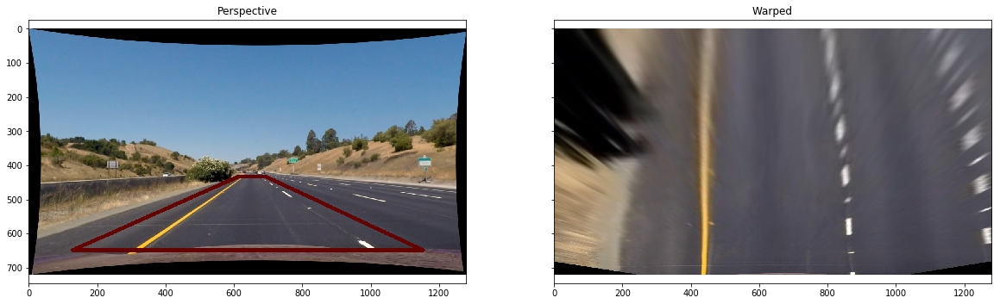

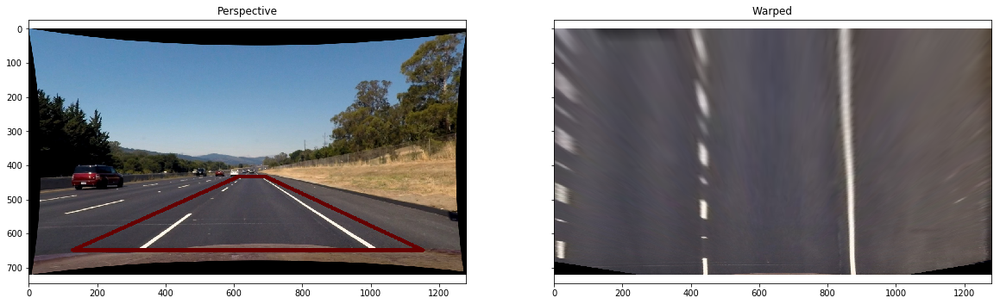

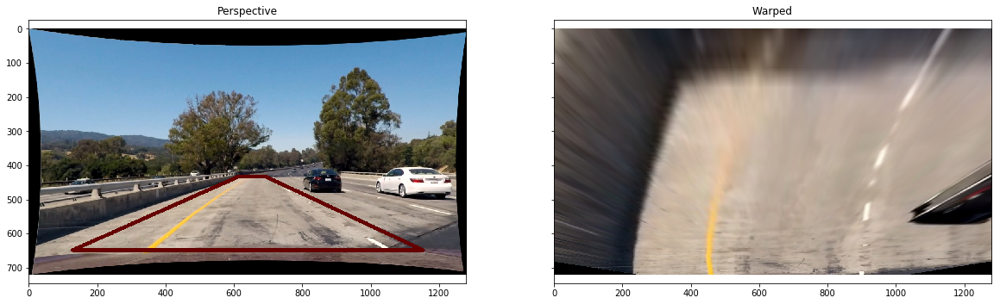

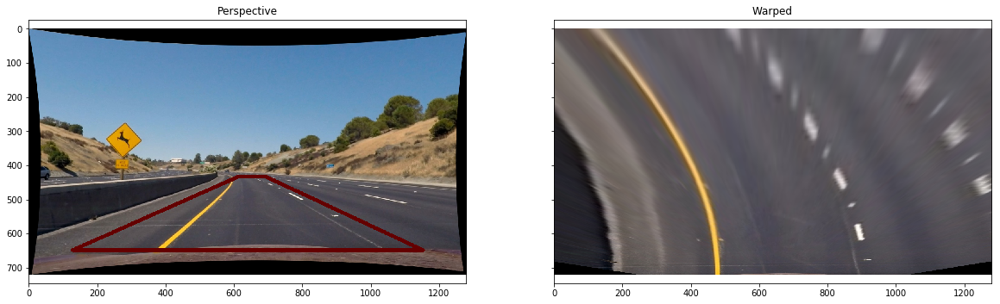

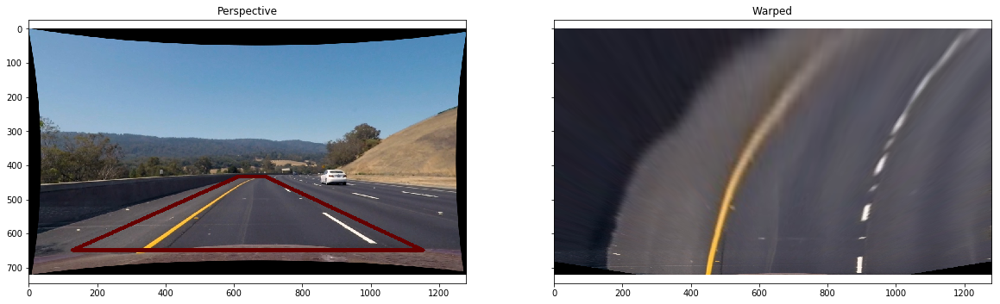

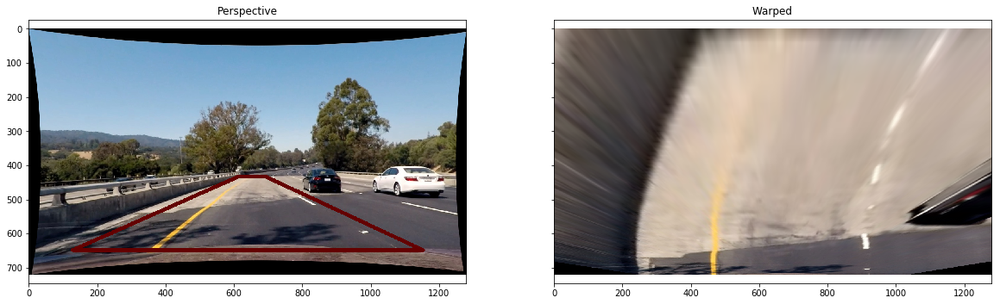

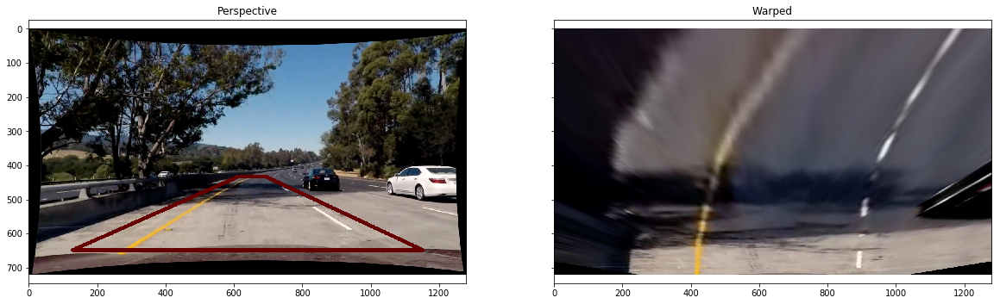

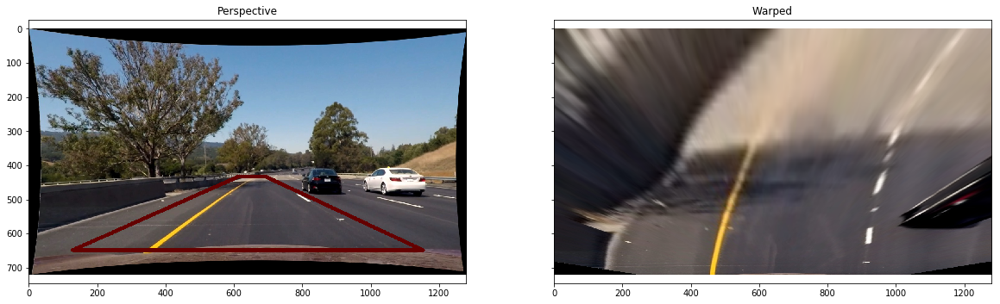

In [54]:
undistort = Rectification(distortion_file=calibration_cache_file, show=False, save=False)

img = mpimg.imread(road_file)
Y, X = img.shape[:2]


class BirdEye(object):

    def __init__(self, shape, save=False, show=False):
        assert isinstance(shape, tuple)
        assert len(shape) == 2
        self.shape = shape

        self.upper_left = [int(0.1 * X), int(0.9 * Y)]
        self.upper_right = [int(0.9 * X), int(0.9 * Y)]
        self.mid_right = [int((0.54) * X), int(0.6 * Y)]
        self.mid_left = [int(0.48 * X), int(0.6 * Y)]        

        self.source_points = [self.upper_left, self.mid_left, self.mid_right, self.upper_right]
        x0 = 0.25 * X
        x1 = X - x0
        self.warped_points = [(x0, Y), (x0, 0), (x1, 0), (x1 ,Y)]
        self.transform_matrix = cv2.getPerspectiveTransform(np.float32(self.source_points), np.float32(self.warped_points))

    def transform(self, img):
        unwarped = cv2.warpPerspective(img, self.transform_matrix, self.shape, flags=cv2.INTER_LINEAR)
        return unwarped
    
    def lines(self):
         return [[self.upper_left + self.upper_right], [self.upper_right + self.mid_right], \
                   [self.mid_right + self.mid_left], [self.mid_left + self.upper_left]]


bird_eye = BirdEye(shape=(X, Y))
for i, img_file in enumerate(sorted(glob.glob('test_images/*.jpg'))):

    img = mpimg.imread(img_file)
    img = undistort.rectify(img)
    unwarped = bird_eye.transform(img)
    #     unwarped = cv2.warpPerspective(img, transform_matrix, (X, Y), flags=cv2.INTER_LINEAR)
    
    _tmp = img.copy()
    
    draw_lines(_tmp, bird_eye.lines(), color=[100, 0, 0], thickness=10)
    _, axes = setup_figure(2, X, Y)
    
    axes[0].imshow(_tmp)
    axes[0].set_title("Perspective")
    
    axes[1].imshow(unwarped)
    axes[1].set_title("Warped")
    
    stacked = np.concatenate((_tmp, unwarped), axis=1)
    cv2.imwrite("{}/4_birdeye_view_{}".format(OUT, os.path.split(img_file)[-1]), cv2.cvtColor(stacked, cv2.COLOR_BGR2RGB))

plt.imshow(unwarped)


# 5. Detect lane pixels

## Lane Masking 

* Detect lane pixels and fit to find the lane boundary.
* Reuse MaskPipeline with a trapezoid that is a rectangle

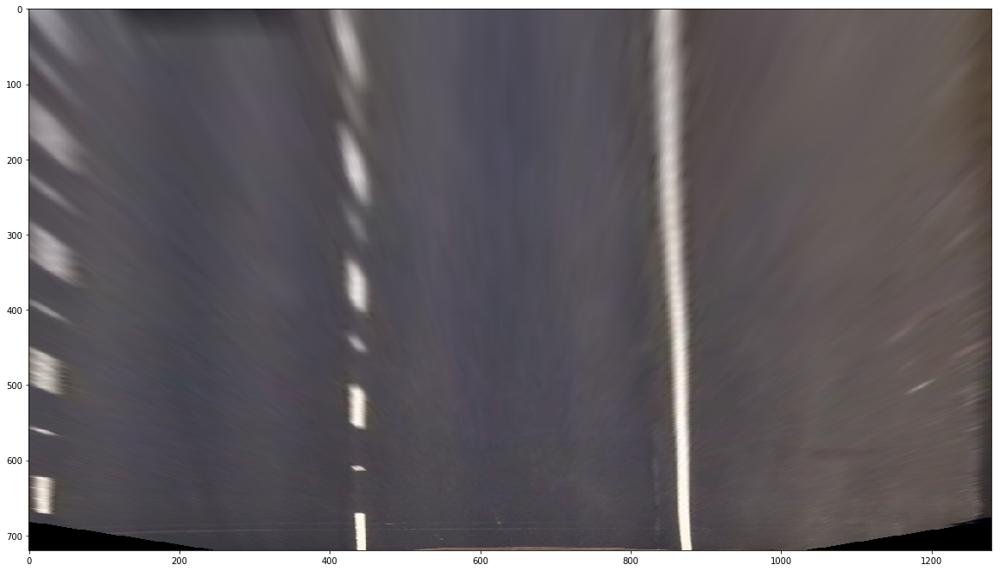

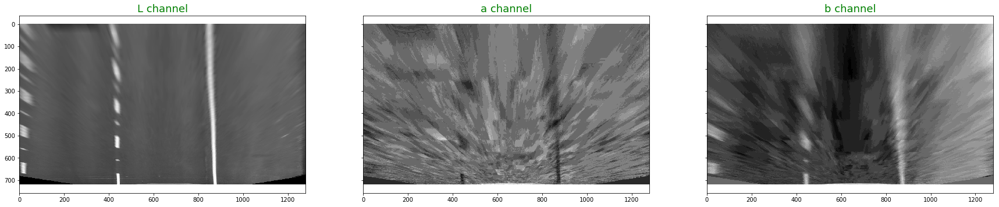

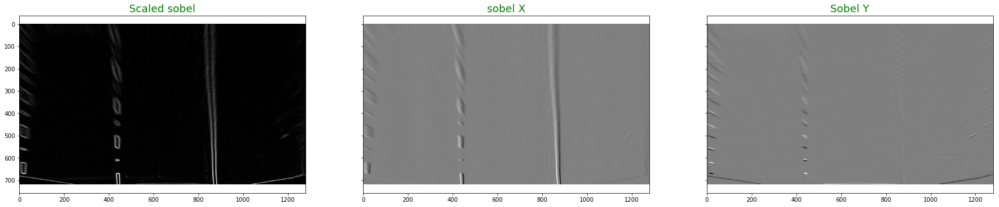

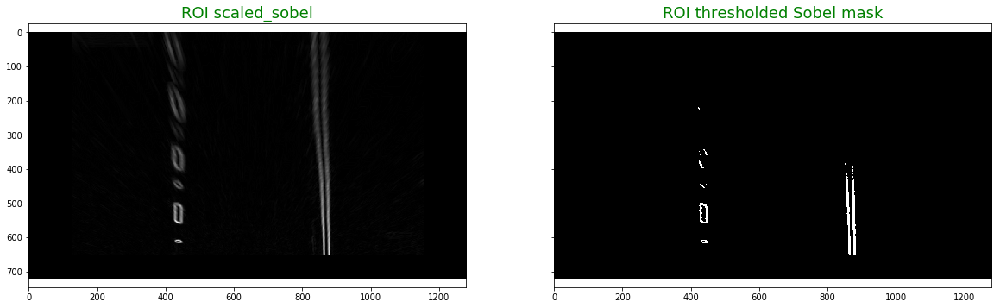

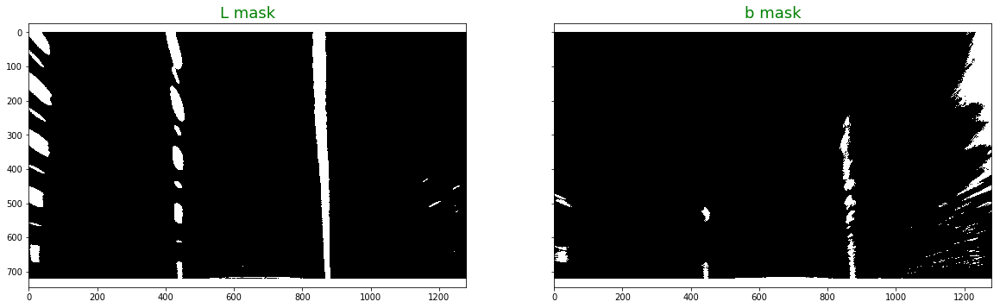

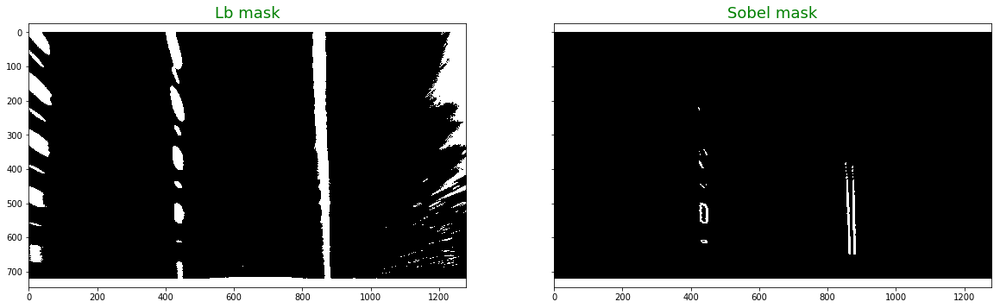

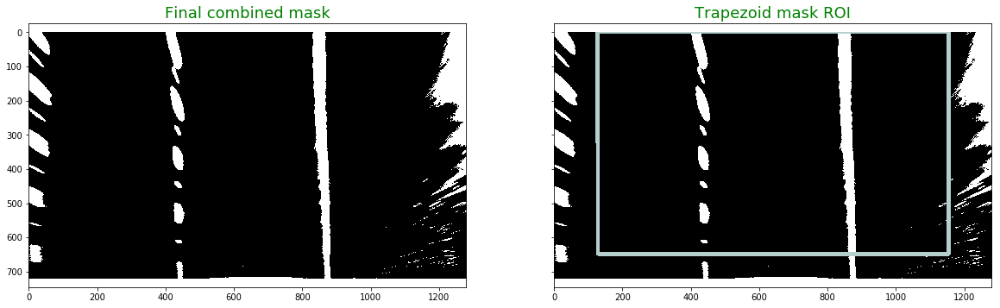

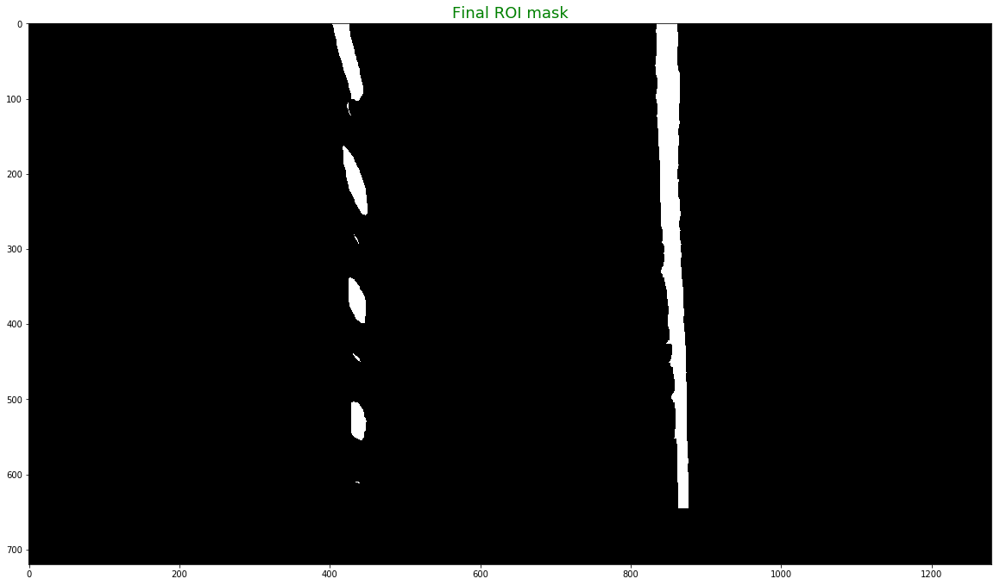

In [55]:
trapzoid_params = {"x_l": 0.1, "x_h": 0.4, "y_h":0.9, "y_l": 0.0}
binPipeline = MaskPipeline(show=show, save=save, trapzoid_params=trapzoid_params, nimage=5)

bird_eye = BirdEye(shape=(X, Y))
binPipeline.show = True
for i, img_file in enumerate(glob.glob('test_images/*.jpg')):
    if i == 0:
        continue

    img = mpimg.imread(img_file)
    img = undistort.rectify(img)
    img = bird_eye.transform(img)
        
    cv2.imwrite("{}/5_rectified_{}".format(OUT, os.path.split(img_file)[-1]), cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        
    roi_mask = binPipeline.process(img=img, img_file=img_file)
    binPipeline.show &= False


## Lane localization

* The x_hist function taken from the Udacity quiz

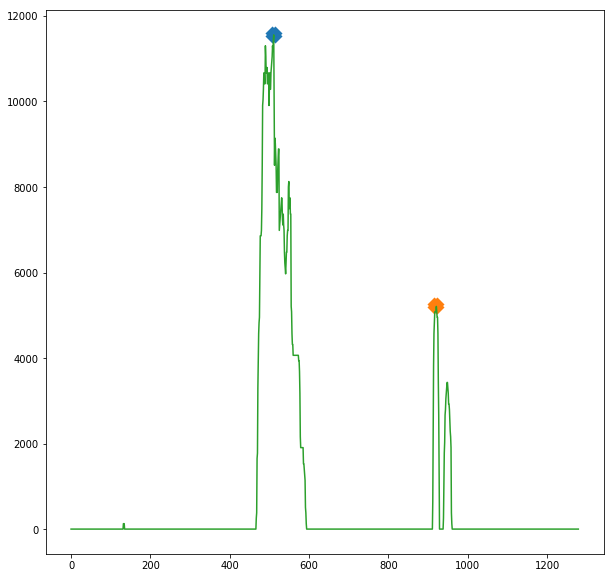

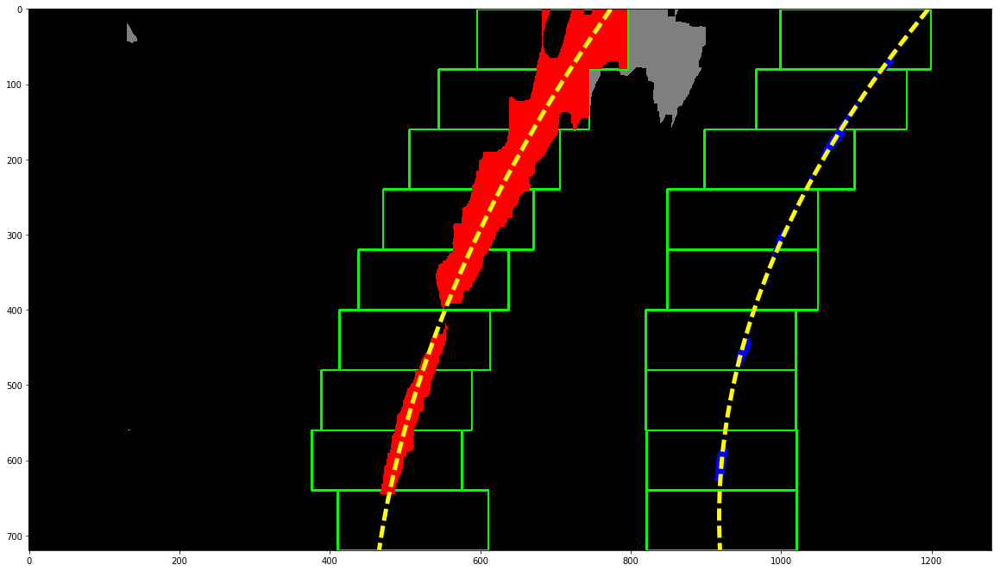

In [56]:
class localization(object):
    
    def __init__(self, save=False, show=False, nimage=-1):
        self.save = save
        self.show = show
        self.nimage = nimage
        
        # hyperparameters
        self.nwindows = 9 # Choose the number of sliding windows
        self.margin = 100 # Set the width of the windows +/- margin
        self.minpix = 50 # Set minimum number of pixels found to recenter window

    @staticmethod
    def x_hist(img):
        bottom_half = img[img.shape[0]//2:, :]
        histogram = np.sum(bottom_half, axis=0)
        return histogram

    def init(self, img, img_file=''):
        
        histogram = self.x_hist(roi_mask)
        
        midpoint = np.int(histogram.shape[0]//2)
        leftx_base = np.argmax(histogram[:midpoint])
        rightx_base = np.argmax(histogram[midpoint:]) + midpoint

        if self.show:
            plt.figure(figsize=(10, 10))
            plt.plot(leftx_base, histogram[leftx_base], marker='x', markeredgewidth=10, markersize=10)
            plt.plot(rightx_base, histogram[rightx_base], marker='x', markeredgewidth=10, markersize=10)
            plt.plot(histogram)
            
            if self.save:
                plt.savefig("{}/{}_histogram_{}".format(OUT, self.nimage, os.path.split(img_file)[-1]))
        
        return leftx_base, rightx_base
    
#     def find_lane_pixels(self, img, base_point, img_file='', nwindows=9):
#         if self.show or self.save:
#             out_img = img.copy()

#         # Set height of windows - based on nwindows above and image shape
#         window_height = np.int(img.shape[0] // nwindows)
#         # Identify the x and y positions of all nonzero pixels in the image
#         nonzero = binary_warped.nonzero()
#         nonzeroy = np.array(nonzero[0])
#         nonzerox = np.array(nonzero[1])
#         # Current positions to be updated later for each window in nwindows
#         x_current = base_point

#         # Create empty lists to receive lane pixel indices
#         lane_inds = []

#         # Step through the windows one by one
#         for window in range(nwindows):
#             # Identify window boundaries in x and y
#             win_y_low = img.shape[0] - (window+1) * window_height
#             win_y_high = img.shape[0] - window * window_height
#             ### TO-DO: Find the four below boundaries of the window ###
#             win_x_low = x_current - margin
#             win_x_high = x_current + margin

#             # Draw the windows on the visualization image
#             cv2.rectangle(out_img,(win_x_low,win_y_low),
#             (win_x_high,win_y_high),(0,255,0), 2) 

#             ### Identify the nonzero pixels in x and y within the window ###
#             good_inds = (nonzeroy >= win_y_low) & (nonzeroy < win_y_high) 
#             good_inds &= (nonzerox >= win_x_low) & (nonzerox < win_x_high)
#             good_inds = good_inds.nonzero()[0]

#             # Append these indices to the lists
#             lane_inds.append(good_inds)

#             ### TO-DO: If you found > minpix pixels, recenter next window on their mean position ###
#             if len(good_inds) > minpix:
#                 x_current = int(np.mean(nonzerox[good_inds]))


#         # Concatenate the arrays of indices (previously was a list of lists of pixels)
#         try:
#             lane_inds = np.concatenate(lane_inds)
#         except ValueError:
#             # Avoids an error if the above is not implemented fully
#             pass

#         # Extract left and right line pixel positions
#         x = nonzerox[lane_inds]
#         y = nonzeroy[lane_inds] 
#         return x, y
  
    
    def find_lane_pixels(self, img):
        # Take a histogram of the bottom half of the image
        histogram = np.sum(img[img.shape[0]//2:,:], axis=0)
        # Create an output image to draw on and visualize the result
        out_img = np.dstack((img, img, img))
        # Find the peak of the left and right halves of the histogram
        # These will be the starting point for the left and right lines
        midpoint = np.int(histogram.shape[0]//2)
        leftx_base = np.argmax(histogram[:midpoint])
        rightx_base = np.argmax(histogram[midpoint:]) + midpoint

        # HYPERPARAMETERS
        # Choose the number of sliding windows
        nwindows = 9
        # Set the width of the windows +/- margin
        margin = 100
        # Set minimum number of pixels found to recenter window
        minpix = 50

        # Set height of windows - based on nwindows above and image shape
        window_height = np.int(img.shape[0]//nwindows)
        # Identify the x and y positions of all nonzero pixels in the image
        nonzero = img.nonzero()
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])
        # Current positions to be updated later for each window in nwindows
        leftx_current = leftx_base
        rightx_current = rightx_base

        # Create empty lists to receive left and right lane pixel indices
        left_lane_inds = []
        right_lane_inds = []

        # Step through the windows one by one
        for window in range(nwindows):
            # Identify window boundaries in x and y (and right and left)
            win_y_low = img.shape[0] - (window+1)*window_height
            win_y_high = img.shape[0] - window*window_height
            ### TO-DO: Find the four below boundaries of the window ###
            win_xleft_low = leftx_current - margin
            win_xleft_high = leftx_current + margin
            win_xright_low = rightx_current - margin
            win_xright_high = rightx_current + margin

            # Draw the windows on the visualization image
            cv2.rectangle(out_img,(win_xleft_low,win_y_low), (win_xleft_high,win_y_high),(0,255,0), 2) 
            cv2.rectangle(out_img,(win_xright_low,win_y_low), (win_xright_high,win_y_high),(0,255,0), 2) 

            ### Identify the nonzero pixels in x and y within the window ###
            good_left_inds = (nonzeroy >= win_y_low) & (nonzeroy < win_y_high) 
            good_left_inds &= (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)
            good_left_inds = good_left_inds.nonzero()[0]

            good_right_inds = (nonzeroy >= win_y_low) & (nonzeroy < win_y_high) 
            good_right_inds &= (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)
            good_right_inds = good_right_inds.nonzero()[0]

            # Append these indices to the lists
            left_lane_inds.append(good_left_inds)
            right_lane_inds.append(good_right_inds)

            ### If you found > minpix pixels, recenter next window ###
            ### (`right` or `leftx_current`) on their mean position ###
            if len(good_left_inds) > minpix:
                leftx_current = int(np.mean(nonzerox[good_left_inds]))

            if len(good_right_inds) > minpix:
                rightx_current = int(np.mean(nonzerox[good_right_inds]))

        # Concatenate the arrays of indices (previously was a list of lists of pixels)
        try:
            left_lane_inds = np.concatenate(left_lane_inds)
            right_lane_inds = np.concatenate(right_lane_inds)
        except ValueError:
            # Avoids an error if the above is not implemented fully
            pass

        # Extract left and right line pixel positions
        leftx = nonzerox[left_lane_inds]
        lefty = nonzeroy[left_lane_inds] 
        rightx = nonzerox[right_lane_inds]
        righty = nonzeroy[right_lane_inds]

        return leftx, lefty, rightx, righty, out_img


    def fit_polynomial(self, img, img_file):
        # Find our lane pixels first
        leftx, lefty, rightx, righty, out_img = self.find_lane_pixels(img)
        #         print("leftx=", leftx)
        ### Fit a second order polynomial to each using `np.polyfit` ###
        left_fit = np.polyfit(lefty, leftx, 2)
        right_fit = np.polyfit(righty, rightx, 2)
        # print("right_fit", right_fit)
        # print("left_fit", left_fit)

        # Generate x and y values for plotting
        ploty = np.linspace(0, img.shape[0]-1, img.shape[0] )
        try:
            left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
            right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
        except TypeError:
            # Avoids an error if `left` and `right_fit` are still none or incorrect
            print('The function failed to fit a line!')
            left_fitx = 1*ploty**2 + 1*ploty
            right_fitx = 1*ploty**2 + 1*ploty

        ## Visualization ##
        # Colors in the left and right lane regions
        out_img[lefty, leftx] = [255, 0, 0]
        out_img[righty, rightx] = [0, 0, 255]

        # Plots the left and right polynomials on the lane lines
        if self.show:
            plt.figure(figsize=(20,20))
            plt.imshow(out_img)
            plt.plot(left_fitx, ploty, color='yellow', linewidth=5, linestyle='--')
            plt.plot(right_fitx, ploty, color='yellow', linewidth=5, linestyle='--')
            
            if self.save:
                plt.savefig("{}/6_lanes_fit_{}".format(OUT, os.path.split(img_file)[-1]))

        return out_img

img_file = glob.glob('test_images/*.jpg')[0]
img = mpimg.imread(img_file)
img = undistort.rectify(img)
img = bird_eye.transform(img)
roi_mask = binPipeline.process(img=img, img_file=img_file)

localizer = localization(save=save, show=show, nimage=6)
leftx_base, rightx_baset = localizer.init(roi_mask, img_file)
out_img = localizer.fit_polynomial(roi_mask, img_file)
